---

# Analysis of Data

---

In [226]:
import pandas as pd

# Read data from CSV file
df = pd.read_csv('csv/data.csv')
=display(df.head())

,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long
0,1218008600,2024-12-29,2024-12-29,1,111,111,11,-2.0,3,6.336634,"Chicago, Illinois, United States",41.85,-87.6501
1,1218059434,2024-12-29,2024-12-29,1,90,90,9,-2.0,10,-6.250000,"Chicago, Illinois, United States",41.85,-87.6501
2,1217968727,2024-12-29,2024-12-29,1,111,111,11,-2.0,4,0.806952,"Chicago, Illinois, United States",41.85,-87.6501
3,1218064446,2024-12-29,2024-12-29,1,90,90,9,-2.0,10,0.884956,"Chicago, Illinois, United States",41.85,-87.6501
4,1218009043,2024-12-29,2024-12-29,1,111,111,11,-2.0,3,6.336634,"Chicago, Illinois, United States",41.85,-87.6501


---

# Check for duplicates

---

In [213]:
# Identify duplicate GlobalEventID values
duplicate_event_ids = df[df.duplicated('GlobalEventID', keep=False)]

# Create a new DataFrame with rows that have the same GlobalEventID
df_same_event_id = df[df['GlobalEventID'].isin(duplicate_event_ids['GlobalEventID'])]

# Sort the DataFrame by GlobalEventID
df_same_event_id_sorted = df_same_event_id.sort_values(by='GlobalEventID')

display(df_same_event_id_sorted)

,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long
179939,233627634,2012-05-20,2013-02-05,0,141,141,14,-6.5,20,3.751617,"Chicago, Illinois, United States",41.85,-87.6501
202204,233627634,2009-01-14,2013-02-05,1,90,90,9,-2.0,6,7.282913,"Chicago, Illinois, United States",41.85,-87.6501
193639,233659152,2010-10-31,2013-02-05,1,111,111,11,-2.0,3,6.049822,"Chicago, Illinois, United States",41.85,-87.6501
206343,233659152,2007-10-18,2013-02-05,1,90,90,9,-2.0,4,4.609929,"Chicago, Illinois, United States",41.85,-87.6501
172277,253732581,2013-03-10,2013-04-09,0,90,90,9,-2.0,20,2.592137,"Chicago, Illinois, United States",41.85,-87.6501
172278,253732581,2013-03-10,2013-04-09,0,90,90,9,-2.0,20,2.592137,"Chicago, Illinois, United States",41.85,-87.6501
172191,253858756,2013-03-13,2013-04-12,1,111,111,11,-2.0,10,3.103448,"Chicago, Illinois, United States",41.85,-87.6501
172210,253858756,2013-03-13,2013-04-12,1,111,111,11,-2.0,10,3.103448,"Chicago, Illinois, United States",41.85,-87.6501
181047,254416949,2012-04-30,2013-04-30,0,111,111,11,-2.0,8,1.294498,"Chicago, Illinois, United States",41.85,-87.6501
181053,254416949,2012-04-30,2013-04-30,0,111,111,11,-2.0,8,1.294498,"Chicago, Illinois, United States",41.85,-87.6501


In [214]:
# Identify rows with the same GlobalEventID and IsRootEvent
duplicate_event_ids_isrootevent = df[df.duplicated(df.columns, keep=False)]

# Display the DataFrame with rows that have the same GlobalEventID and IsRootEvent
display(duplicate_event_ids_isrootevent)

,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long
172191,253858756,2013-03-13,2013-04-12,1,111,111,11,-2.0,10,3.103448,"Chicago, Illinois, United States",41.85,-87.6501
172210,253858756,2013-03-13,2013-04-12,1,111,111,11,-2.0,10,3.103448,"Chicago, Illinois, United States",41.85,-87.6501
172277,253732581,2013-03-10,2013-04-09,0,90,90,9,-2.0,20,2.592137,"Chicago, Illinois, United States",41.85,-87.6501
172278,253732581,2013-03-10,2013-04-09,0,90,90,9,-2.0,20,2.592137,"Chicago, Illinois, United States",41.85,-87.6501
181047,254416949,2012-04-30,2013-04-30,0,111,111,11,-2.0,8,1.294498,"Chicago, Illinois, United States",41.85,-87.6501
181053,254416949,2012-04-30,2013-04-30,0,111,111,11,-2.0,8,1.294498,"Chicago, Illinois, United States",41.85,-87.6501


---

Later I've decided to only look at data after 2020, so these are all irrelevant

---

---

# Location

Checking for Patterns in Unique Locations

Questions we'll investigate:
* Do certain periods have more unique locations that others? 
* Why are there more counts of unique locations

---

In [215]:
# Filter the dataframe for EventBaseCode of 145 and Date between 2018 and 2019
filtered_df_2018_to_2019 = df[(df['EventBaseCode'] == 145) & (df['Date'] >= '2018-01-01') & (df['Date'] <= '2019-12-31')]

# Print the full list of unique locations
unique_locations_2018_to_2019 = filtered_df_2018_to_2019[['ActionGeo_Lat', 'ActionGeo_Long']].drop_duplicates()
print(f"Count of unique locations:\n{unique_locations_2018_to_2019.nunique()}")
#display(unique_locations_2018_to_2019)

Count of unique locations:
ActionGeo_Lat     10
ActionGeo_Long    10
dtype: int64


In [216]:
# Filter the dataframe for EventBaseCode of 145 and Date between 2019 and 2020
filtered_df_2019_to_2020 = df[(df['EventBaseCode'] == 145) & (df['Date'] >= '2019-01-01') & (df['Date'] <= '2020-12-31')]

# Print the full list of unique locations
unique_locations_2019_to_2020 = filtered_df_2019_to_2020[['ActionGeo_Lat', 'ActionGeo_Long']].drop_duplicates()
print(f"Count of unique locations:\n{unique_locations_2019_to_2020.nunique()}")
#display(unique_locations_2019_to_2020)

Count of unique locations:
ActionGeo_Lat     31
ActionGeo_Long    31
dtype: int64


In [217]:
# Filter the dataframe for EventBaseCode of 145 and Date between 2020 and 2021
filtered_df_2020_to_2021 = df[(df['EventBaseCode'] == 145) & (df['Date'] >= '2020-01-01') & (df['Date'] <= '2021-12-31')]

# Print the full list of unique locations
unique_locations_2020_to_2021 = filtered_df_2020_to_2021[['ActionGeo_Lat', 'ActionGeo_Long']].drop_duplicates()
print(f"Count of unique locations:\n{unique_locations_2020_to_2021.nunique()}")
#display(unique_locations_2020_to_2021)

Count of unique locations:
ActionGeo_Lat     35
ActionGeo_Long    35
dtype: int64


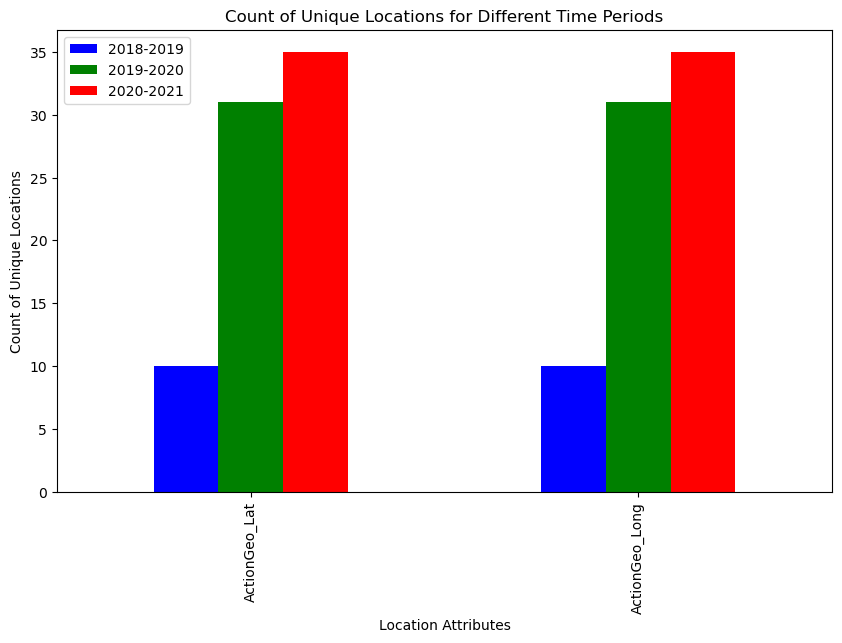

In [218]:
import matplotlib.pyplot as plt

# Get the count of unique locations for each segment
unique_counts_2018_to_2019 = unique_locations_2018_to_2019.nunique()
unique_counts_2019_to_2020 = unique_locations_2019_to_2020.nunique()
unique_counts_2020_to_2021 = unique_locations_2020_to_2021.nunique()

# Combine the counts into a single DataFrame
unique_counts = pd.DataFrame({
    '2018-2019': unique_counts_2018_to_2019,
    '2019-2020': unique_counts_2019_to_2020,
    '2020-2021': unique_counts_2020_to_2021
})

# Plot the histogram
unique_counts.plot(kind='bar', figsize=(10, 6), color=['blue', 'green', 'red'])
plt.xlabel('Location Attributes')
plt.ylabel('Count of Unique Locations')
plt.title('Count of Unique Locations for Different Time Periods')
plt.show()

---

Clearly there was some change in the way that locations were programmed into the data set at this point. 

If I have more specific locations, my model will be able to predict more accurately.

Let's try to scope down the model only activity in and after 2020 to make it more accurate by location.

---

In [219]:
# Filter the dataframe to include only rows with Date from 2020 onwards
data_cleaned = df[df['Date'] >= '2020-01-01']

---

Let's see just take a look at the number of unqiue locations, and see the relationship between `ActionGeo_FullName` and lat, and long. The goal here is to unpack how valuable the lat / long is for modeling purposes.

---

In [ ]:
# Group by ActionGeo_FullName, ActionGeo_Lat, and ActionGeo_Long and count the occurrences
location_name_counts = data_cleaned.groupby(['ActionGeo_FullName', 'ActionGeo_Lat', 'ActionGeo_Long']).size().reset_index(name='count').sort_values(by='count', ascending=False)

# Display the result
display(location_name_counts)

,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,count
29,"Chicago, Illinois, United States",41.8500,-87.6501,58345
20,"Chicago Fire Department, Illinois, United States",41.9526,-87.6727,258
84,"Logan Square, Illinois, United States",41.9234,-87.6992,247
82,"Lincoln Park, Illinois, United States",41.9217,-87.6478,199
33,"City Of Chicago, Illinois, United States",41.8368,-87.6845,173
...,...,...,...,...
80,"Lincoln Park Presbyterian Church, Illinois, Un...",41.9259,-87.6442,1
77,"Lasalle Language Academy, Illinois, United States",41.9136,-87.6378,1
135,"Smith School, Illinois, United States",41.8595,-87.7217,1
76,"Lake Meadows, Illinois, United States",41.8356,-87.6137,1


In [ ]:
# Group by latitude and longitude and aggregate the names
grouped_locations = location_name_counts.groupby(['ActionGeo_Lat', 'ActionGeo_Long'])['ActionGeo_FullName'].agg(lambda x: list(set(x))).reset_index()

# Split the old and new ActionGeo_FullName into two columns
grouped_locations['ActionGeo_FullName_1'] = grouped_locations['ActionGeo_FullName'].apply(lambda x: x[0] if len(x) > 0 else None)
grouped_locations['ActionGeo_FullName_2'] = grouped_locations['ActionGeo_FullName'].apply(lambda x: x[1] if len(x) > 1 else None)

# Drop the ActionGeo_FullName column
grouped_locations = grouped_locations.drop(columns=['ActionGeo_FullName'])

# Filter the groups that have more than one name
duplicated_locations = grouped_locations[grouped_locations['ActionGeo_FullName_2'].notnull()]

# Display the result
display(duplicated_locations)

,ActionGeo_Lat,ActionGeo_Long,ActionGeo_FullName_1,ActionGeo_FullName_2
41,41.8717,-87.6342,"Rivercity, Illinois, United States","River City, Illinois, United States"
71,41.8800,-87.6667,"Near Westside, Illinois, United States","Near West Side, Illinois, United States"
110,41.8946,-87.6220,"Northwestern Memorialhospital, Illinois, Unite...","Northwestern Memorial Hospital, Illinois, Unit..."


---

This is a small error. Doesn't matter at all. Just more indiciation that the Location Name is the same as the Lat / Long, but that Lat / Long are more reliable information to build a model with.

tl;dr Lat and Long are very low information data sources. What likely happens is that when the GDELT information is updated, and a `location name` is read into the event description, it takes the event `location name` and then provides the lat / long based off some table. So if an article just says an event was in Chicago, then that's all the specificity we get about the location of the event.

tl;dr we won't get much granular information about if the event is proximal to our commute, and the signifigance of the lat / long is pretty weak. 

---

In [ ]:
# Create a dictionary mapping incorrect names to correct names
name_corrections = {
    duplicated_locations.iloc[0]['ActionGeo_FullName_1']: duplicated_locations.iloc[0]['ActionGeo_FullName_2'],
    duplicated_locations.iloc[1]['ActionGeo_FullName_1']: duplicated_locations.iloc[1]['ActionGeo_FullName_2'],
    duplicated_locations.iloc[2]['ActionGeo_FullName_1']: duplicated_locations.iloc[2]['ActionGeo_FullName_2']
}

# Print the changes
print("Name corrections applied:")
for incorrect, correct in name_corrections.items():
    print(f"\t{incorrect} -> {correct}")

# Apply the replace method to fix the discrepancies
data_cleaned.loc[:, 'ActionGeo_FullName'] = data_cleaned['ActionGeo_FullName'].replace(name_corrections)

# Display the updated DataFrame to verify the changes
display(data_cleaned[['ActionGeo_FullName', 'ActionGeo_Lat', 'ActionGeo_Long']].drop_duplicates())

Name corrections applied:
	Rivercity, Illinois, United States -> River City, Illinois, United States
	Near Westside, Illinois, United States -> Near West Side, Illinois, United States
	Northwestern Memorialhospital, Illinois, United States -> Northwestern Memorial Hospital, Illinois, United States


,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long
0,"Chicago, Illinois, United States",41.8500,-87.6501
141,"Rush University, Illinois, United States",41.8736,-87.6695
162,"City Of Chicago, Illinois, United States",41.8368,-87.6845
166,"Lincoln Park, Illinois, United States",41.9217,-87.6478
197,"Chicago Fire Department, Illinois, United States",41.9526,-87.6727
...,...,...,...
56839,"Holy Name Cathedral, Illinois, United States",41.8959,-87.6276
57876,"Delaware Building, Illinois, United States",41.8848,-87.6292
59757,"Seton Hall, Illinois, United States",41.9261,-87.6534
61027,"Standard Club, Illinois, United States",41.8775,-87.6289


---

We've now fixed the naming error in the dataset.

---

---

### Thoughts on Location Data

All events are definetly "in Chicago," and sometimes we know the accuracy of an events location beter than other events. Sometimes we just know "an event is in Chicago" and other times we know "an event was in Lincoln Park."

If I know a big riot was in Lincoln Park, then that's more useful information that if an event was location "In Chicago," yet in my perticular commute, I went through the loop and took public transport. I was constantly in the "heart" of Chicago.

For the purposes of knowing if the event would "disrupt my commute," then I don't think the distance would be all that important. Surely a riot right at my train stop would be worse than a riot a mile away, but ultimately the city wouldn't be very safe in both scinarios, so for the purposes of conservative travel, we can treat them all the same. 

Perhaps this is an area we can return to to see if it's possible to gather more accurate data. One idea would be to give vague references like "Chicago" some average distance of the rest of the events, but then with specific events we could look at their unique distance. This would bring in the physical distance into some score to help evaluate the risk of the commute, yet this isn't something I want to handle right now. #TODO

---

# Events over Time

---

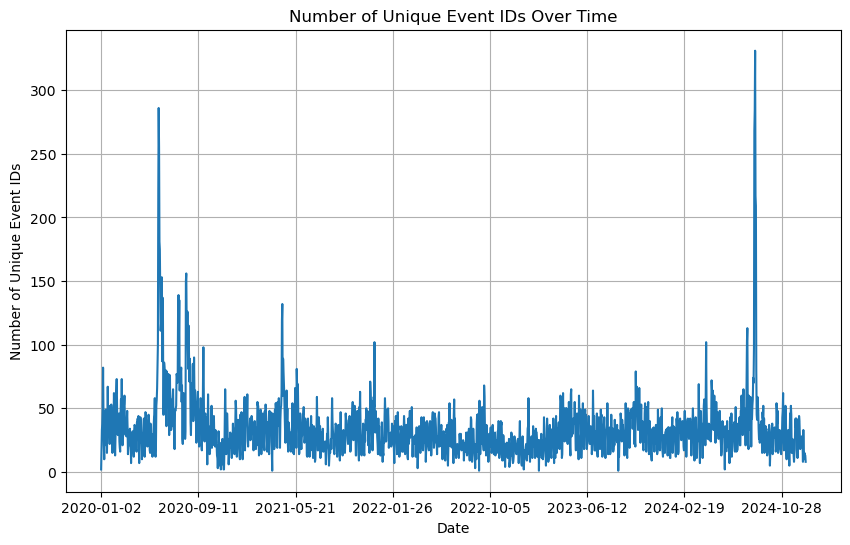

In [220]:
import matplotlib.pyplot as plt

# Group by Date and count unique GlobalEventID
events_per_date = data_cleaned.groupby('Date')['GlobalEventID'].nunique()

# Filter events_per_date to include only dates from 1985 onwards
events_per_date_filtered = events_per_date[events_per_date.index >= '1985-01-01']

# Plot the number of unique event IDs over time
events_per_date_filtered.plot(kind='line', figsize=(10, 6), title='Number of Unique Event IDs Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Unique Event IDs')
plt.grid(True)
plt.show()


/var/folders/bh/bs5kljm140s_4k8bp_hzf8n00000gn/T/ipykernel_58005/3463896363.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  filtered_df = data_cleaned[(df['EventBaseCode'] == 145) & (df['Date'] >= '2010-01-01')]


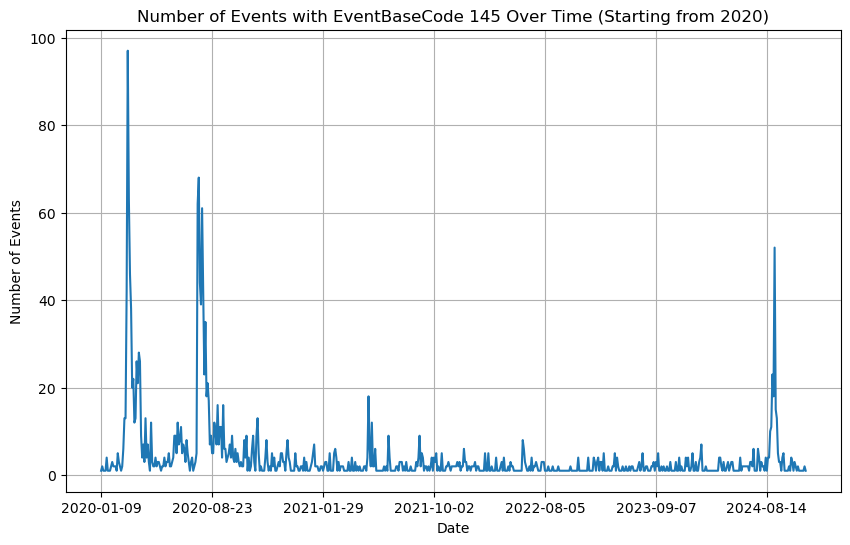

In [221]:
# Filter the dataframe for EventBaseCode of 145 and Date starting from 2010
filtered_df = data_cleaned[(df['EventBaseCode'] == 145) & (df['Date'] >= '2010-01-01')]

# Group by Date and count the number of events
events_145_per_date = filtered_df.groupby('Date').size()

# Plot the number of events with EventBaseCode 145 over time
events_145_per_date.plot(kind='line', figsize=(10, 6), title='Number of Events with EventBaseCode 145 Over Time (Starting from 2020)')
plt.xlabel('Date')
plt.ylabel('Number of Events')
plt.grid(True)
plt.show()

---

# Event Input Lag

---

---

Real quick, I just want to audit the lag between events being recorded and the actual event occuring.

---

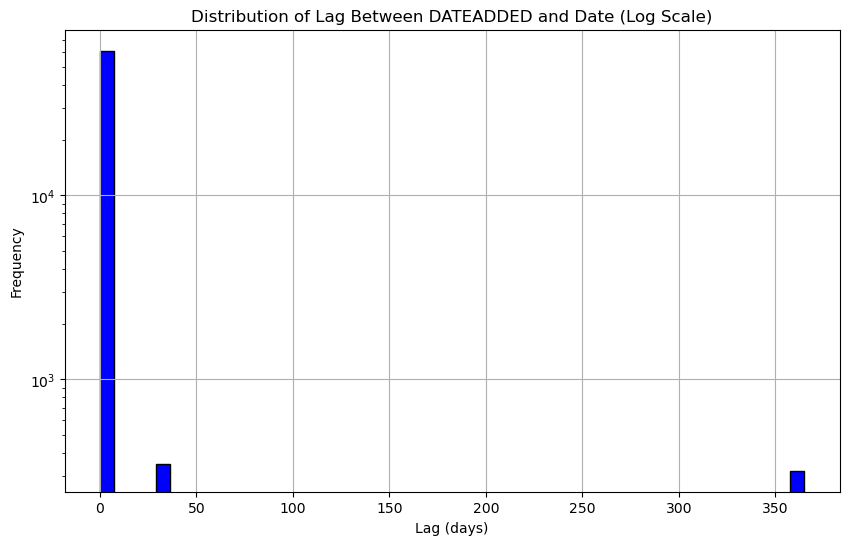

In [228]:
import matplotlib.pyplot as plt

# Convert 'Date' and 'DATEADDED' to datetime
data_cleaned['Date'] = pd.to_datetime(data_cleaned['Date'])
data_cleaned['DATEADDED'] = pd.to_datetime(data_cleaned['DATEADDED'], format='%Y-%m-%d')

# Calculate the difference in days between 'DATEADDED' and 'Date'
data_cleaned['Lag'] = (data_cleaned['DATEADDED'] - data_cleaned['Date']).dt.days

#TODO the following is not depreciated, but somehow when managing object type, it breaks... this is something to fix later, but 
# the current code should work every time
'''# Convert 'Date' and 'DATEADDED' to datetime
data_cleaned.loc[:, 'Date'] = pd.to_datetime(data_cleaned['Date'])
data_cleaned.loc[:, 'DATEADDED'] = pd.to_datetime(data_cleaned['DATEADDED'], format='%Y-%m-%d')

# Calculate the difference in days between 'DATEADDED' and 'Date'
data_cleaned.loc[:, 'Lag'] = (data_cleaned['DATEADDED'] - data_cleaned['Date']).dt.days'''


# Plot the distribution of the lag with a logarithmic scale
plt.figure(figsize=(10, 6))
plt.hist(data_cleaned['Lag'], bins=50, color='blue', edgecolor='black')
plt.yscale('log')
plt.title('Distribution of Lag Between DATEADDED and Date (Log Scale)')
plt.xlabel('Lag (days)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [229]:
from sklearn.cluster import DBSCAN

# Extract the 'Lag' column for clustering
lag_data = data_cleaned[['Lag']]

# Apply DBSCAN clustering
dbscan = DBSCAN(eps=5, min_samples=10)  # You can adjust eps and min_samples as needed
data_cleaned.loc[:, 'LagCluster'] = dbscan.fit_predict(lag_data)

In [230]:
# Display the first few rows to see the cluster assignments
display(data_cleaned[['Lag', 'LagCluster']])

,Lag,LagCluster
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
...,...,...
61843,30,2
61844,30,2
61845,0,0
61846,365,3


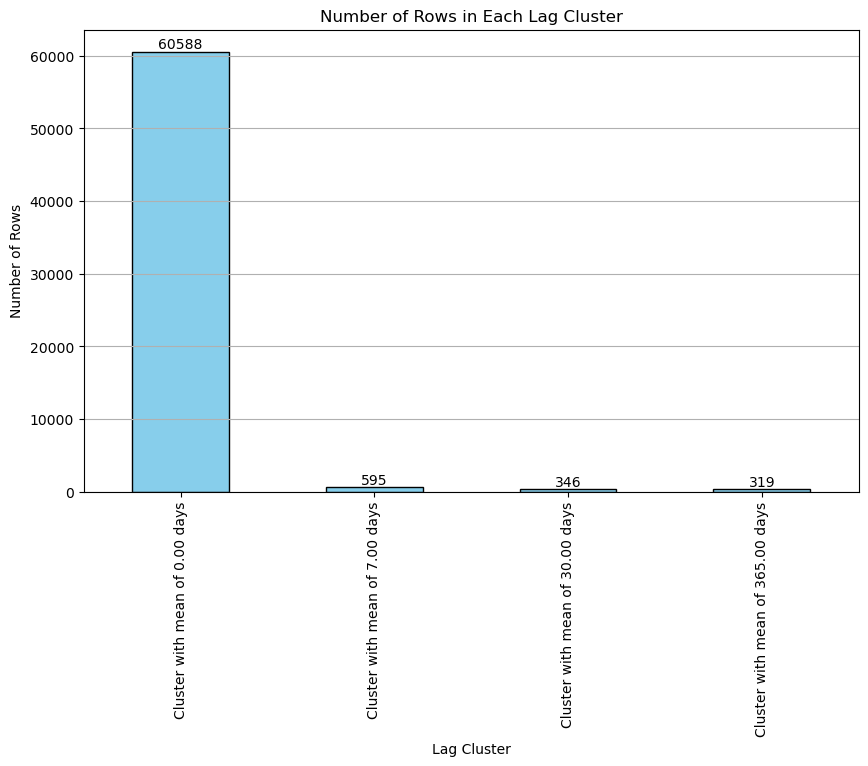

In [231]:
# Count the number of rows in each lag cluster
lag_cluster_counts = data_cleaned['LagCluster'].value_counts()

# Get the mean lag for each cluster
lag_cluster_means = data_cleaned.groupby('LagCluster')['Lag'].mean()

# Plot the bar chart
plt.figure(figsize=(10, 6))
bars = lag_cluster_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.xlabel('Lag Cluster')
plt.ylabel('Number of Rows')
plt.title('Number of Rows in Each Lag Cluster')
plt.grid(axis='y')

# Add count labels on top of each bar
for bar in bars.patches:
    cluster = int(bar.get_x() + bar.get_width() / 2)
    count = lag_cluster_counts[cluster]
    bars.annotate(f'{count}', 
                  (bar.get_x() + bar.get_width() / 2, bar.get_height()), 
                  ha='center', va='bottom')

# Update x-axis labels to show mean lag
bars.set_xticklabels([f'Cluster with mean of {lag_cluster_means[cluster]:.2f} days' for cluster in lag_cluster_counts.index])

plt.show()

---

What are in these delayed clusters?

---

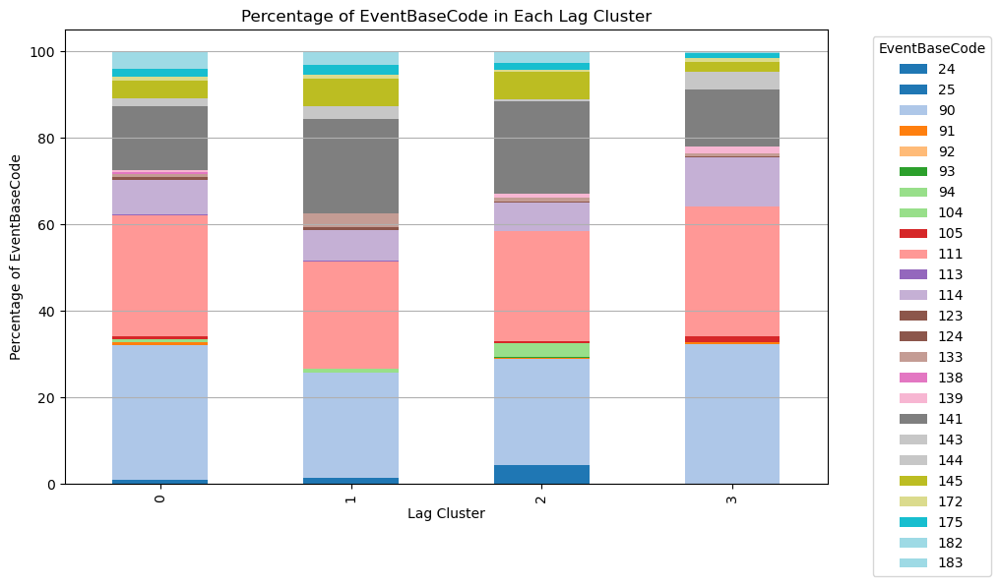

In [232]:
import matplotlib.pyplot as plt

# Calculate the count of EventBaseCode for each LagCluster
eventbasecode_counts = data_cleaned.groupby(['LagCluster', 'EventBaseCode']).size().unstack(fill_value=0)

# Calculate the percentage of each EventBaseCode within each LagCluster
eventbasecode_percentage = eventbasecode_counts.div(eventbasecode_counts.sum(axis=1), axis=0) * 100

# Plot the stacked bar chart
ax = eventbasecode_percentage.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='tab20')

# Set labels and title
plt.xlabel('Lag Cluster')
plt.ylabel('Percentage of EventBaseCode')
plt.title('Percentage of EventBaseCode in Each Lag Cluster')
plt.legend(title='EventBaseCode', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y')

# Show the plot
plt.show()

---

There doesn't seem to be a pattern in the types of events that are delayed in being registered into GDELT.

---

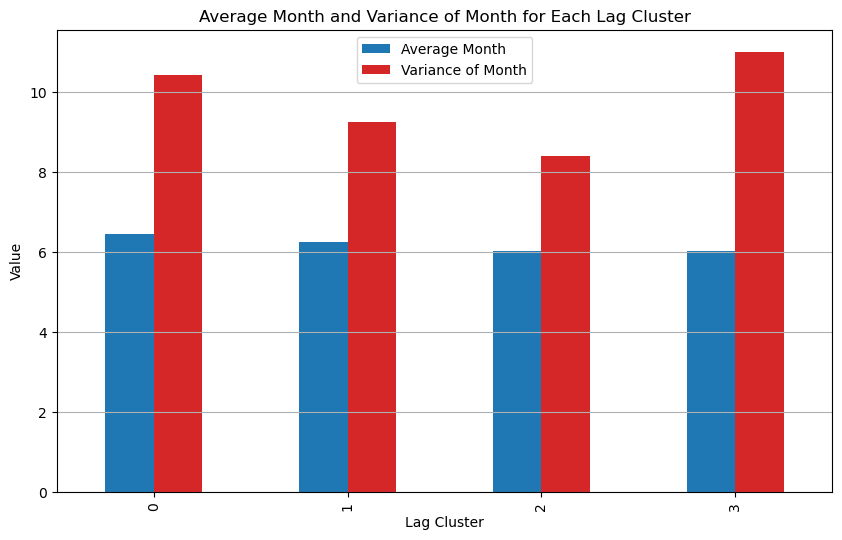

In [233]:
# Extract the month from the 'Date' column
data_cleaned.loc[:, 'Month'] = data_cleaned['Date'].dt.month

# Calculate the average month and variance of the month for each lag cluster
avg_month_per_cluster = data_cleaned.groupby('LagCluster')['Month'].mean()
var_month_per_cluster = data_cleaned.groupby('LagCluster')['Month'].var()

# Combine the average and variance into a single DataFrame
month_stats_per_cluster = pd.DataFrame({
    'Average Month': avg_month_per_cluster,
    'Variance of Month': var_month_per_cluster
})

# Plot the bar chart
month_stats_per_cluster.plot(kind='bar', figsize=(10, 6), color=['tab:blue', 'tab:red'])
plt.xlabel('Lag Cluster')
plt.ylabel('Value')
plt.title('Average Month and Variance of Month for Each Lag Cluster')
plt.grid(axis='y')
plt.show()


---

There's no pattern in the time of year that the lag clusters around.

---

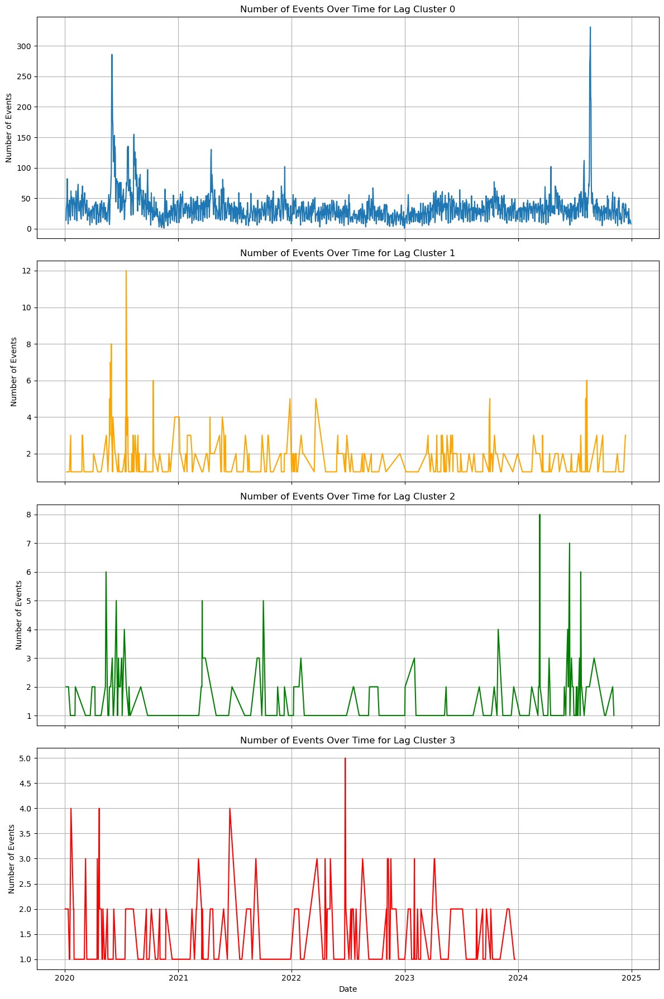

In [234]:
import matplotlib.pyplot as plt

# Filter data for each lag cluster
lag_cluster_0 = data_cleaned[data_cleaned['LagCluster'] == 0]
lag_cluster_1 = data_cleaned[data_cleaned['LagCluster'] == 1]
lag_cluster_2 = data_cleaned[data_cleaned['LagCluster'] == 2]
lag_cluster_3 = data_cleaned[data_cleaned['LagCluster'] == 3]

# Group by Date and count the number of events for each lag cluster
events_lag_0 = lag_cluster_0.groupby('Date').size()
events_lag_1 = lag_cluster_1.groupby('Date').size()
events_lag_2 = lag_cluster_2.groupby('Date').size()
events_lag_3 = lag_cluster_3.groupby('Date').size()

# Plot the number of events over time for each lag cluster
fig, axs = plt.subplots(4, 1, figsize=(12, 18), sharex=True)

axs[0].plot(events_lag_0.index, events_lag_0.values, label='Lag Cluster 0')
axs[0].set_title('Number of Events Over Time for Lag Cluster 0')
axs[0].set_ylabel('Number of Events')
axs[0].grid(True)

axs[1].plot(events_lag_1.index, events_lag_1.values, label='Lag Cluster 1', color='orange')
axs[1].set_title('Number of Events Over Time for Lag Cluster 1')
axs[1].set_ylabel('Number of Events')
axs[1].grid(True)

axs[2].plot(events_lag_2.index, events_lag_2.values, label='Lag Cluster 2', color='green')
axs[2].set_title('Number of Events Over Time for Lag Cluster 2')
axs[2].set_ylabel('Number of Events')
axs[2].grid(True)

axs[3].plot(events_lag_3.index, events_lag_3.values, label='Lag Cluster 3', color='red')
axs[3].set_title('Number of Events Over Time for Lag Cluster 3')
axs[3].set_xlabel('Date')
axs[3].set_ylabel('Number of Events')
axs[3].grid(True)

plt.tight_layout()
plt.show()

---

Each lag clustering tends to have the same distribution over time (obv the less frequent one has a more volitilie distribution)

I'm really not seeing any temporal pattern in the types of events that have more lag.

---

In [235]:
# Display the head of each lag cluster DataFrame
print("Lag Cluster 0:")
display(lag_cluster_0.head())

print("Lag Cluster 1:")
display(lag_cluster_1.head())

print("Lag Cluster 2:")
display(lag_cluster_2.head())

print("Lag Cluster 3:")
display(lag_cluster_3.head())

Lag Cluster 0:


,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,Lag,LagCluster,Month
0,1218008600,2024-12-29,2024-12-29,1,111,111,11,-2.0,3,6.336634,"Chicago, Illinois, United States",41.85,-87.6501,0,0,12
1,1218059434,2024-12-29,2024-12-29,1,90,90,9,-2.0,10,-6.250000,"Chicago, Illinois, United States",41.85,-87.6501,0,0,12
2,1217968727,2024-12-29,2024-12-29,1,111,111,11,-2.0,4,0.806952,"Chicago, Illinois, United States",41.85,-87.6501,0,0,12
3,1218064446,2024-12-29,2024-12-29,1,90,90,9,-2.0,10,0.884956,"Chicago, Illinois, United States",41.85,-87.6501,0,0,12
4,1218009043,2024-12-29,2024-12-29,1,111,111,11,-2.0,3,6.336634,"Chicago, Illinois, United States",41.85,-87.6501,0,0,12


Lag Cluster 1:


,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,Lag,LagCluster,Month
372,1216613724,2024-12-12,2024-12-19,0,90,90,9,-2.0,2,-4.428424,"Chicago, Illinois, United States",41.85,-87.6501,7,1,12
380,1216613721,2024-12-12,2024-12-19,0,90,90,9,-2.0,2,-4.428424,"Chicago, Illinois, United States",41.85,-87.6501,7,1,12
382,1216613725,2024-12-12,2024-12-19,0,90,90,9,-2.0,4,-4.428424,"Chicago, Illinois, United States",41.85,-87.6501,7,1,12
547,1215421315,2024-12-06,2024-12-13,1,141,141,14,-6.5,20,-1.143619,"Chicago, Illinois, United States",41.85,-87.6501,7,1,12
651,1214687304,2024-12-03,2024-12-10,1,111,111,11,-2.0,10,0.664452,"Chicago, Illinois, United States",41.85,-87.6501,7,1,12


Lag Cluster 2:


,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,Lag,LagCluster,Month
1411,1213940625,2024-11-05,2024-12-05,1,90,90,9,-2.0,10,-8.292683,"Chicago, Illinois, United States",41.85,-87.6501,30,2,11
1521,1213030493,2024-11-01,2024-12-01,1,90,90,9,-2.0,12,-8.685714,"Chicago, Illinois, United States",41.85,-87.6501,30,2,11
1530,1213030492,2024-11-01,2024-12-01,1,90,90,9,-2.0,4,-8.685714,"Chicago, Illinois, United States",41.85,-87.6501,30,2,11
2255,1208754309,2024-10-09,2024-11-08,1,90,90,9,-2.0,2,-9.166667,"Chicago, Illinois, United States",41.85,-87.6501,30,2,10
2323,1208390680,2024-10-07,2024-11-06,1,141,141,14,-6.5,3,-1.320132,"Chicago, Illinois, United States",41.85,-87.6501,30,2,10


Lag Cluster 3:


,GlobalEventID,Date,DATEADDED,IsRootEvent,EventCode,EventBaseCode,EventRootCode,GoldsteinScale,NumMentions,AvgTone,ActionGeo_FullName,ActionGeo_Lat,ActionGeo_Long,Lag,LagCluster,Month
13269,1216939869,2023-12-22,2024-12-21,1,90,90,9,-2.0,10,-3.589744,"Chicago, Illinois, United States",41.85,-87.6501,365,3,12
13324,1216576996,2023-12-20,2024-12-19,0,111,111,11,-2.0,4,-0.124611,"Chicago, Illinois, United States",41.85,-87.6501,365,3,12
13821,1213254957,2023-12-03,2024-12-02,0,91,91,9,-2.0,2,-3.235294,"Chicago, Illinois, United States",41.85,-87.6501,365,3,12
13826,1213254960,2023-12-03,2024-12-02,0,91,91,9,-2.0,2,-3.235294,"Chicago, Illinois, United States",41.85,-87.6501,365,3,12
13991,1212130804,2023-11-27,2024-11-26,0,141,141,14,-6.5,3,-2.651515,"Chicago, Illinois, United States",41.85,-87.6501,365,3,11


---

Looking at the raw data isn't super helpful, but it gave me the idea to think about AvgTone.

---

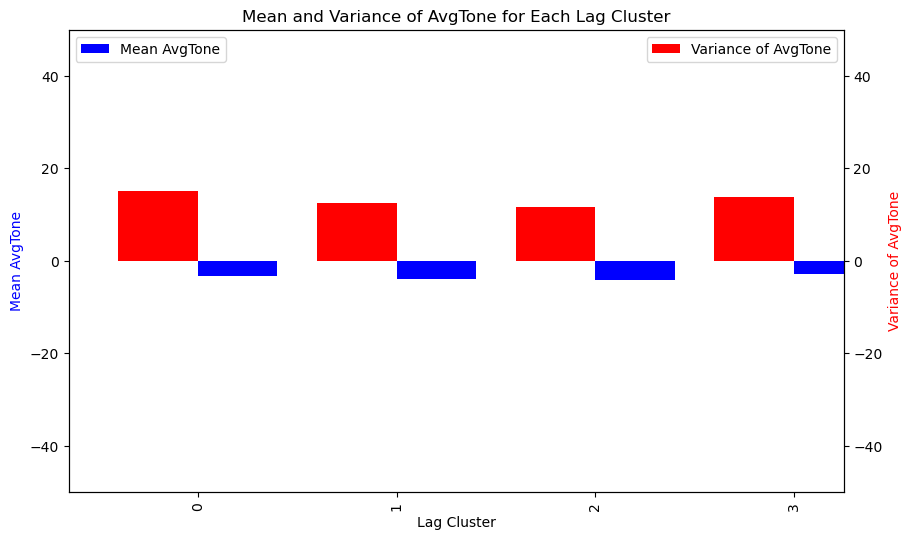

In [236]:
import matplotlib.pyplot as plt

# Calculate the mean and variance of AvgTone for each cluster
avg_tone_stats_per_cluster = data_cleaned.groupby('LagCluster')['AvgTone'].agg(['mean', 'var'])

# Plot the bar chart
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot the mean AvgTone
avg_tone_stats_per_cluster['mean'].plot(kind='bar', color='blue', ax=ax1, position=0, width=0.4, label='Mean AvgTone')

# Create a second y-axis to plot the variance
ax2 = ax1.twinx()
avg_tone_stats_per_cluster['var'].plot(kind='bar', color='red', ax=ax2, position=1, width=0.4, label='Variance of AvgTone')

# Set labels and title
ax1.set_xlabel('Lag Cluster')
ax1.set_ylabel('Mean AvgTone', color='blue')
ax2.set_ylabel('Variance of AvgTone', color='red')
plt.title('Mean and Variance of AvgTone for Each Lag Cluster')

# Set y-axis limits
ax1.set_ylim(-50, 50)
ax2.set_ylim(-50, 50)

# Add legends
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()

---

No clear pattern here between the clusters.

---

---

What about location?

---

In [237]:
import folium

# Create a map centered around Chicago
m = folium.Map(location=[41.85, -87.65], zoom_start=13)

# Define colors for each lag cluster
colors = {0: 'blue', 1: 'green', 2: 'orange', 3: 'red'}

# Function to add markers to the map
def add_markers(df, color):
    for _, row in df.iterrows():
        folium.CircleMarker(
            location=[row['ActionGeo_Lat'], row['ActionGeo_Long']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color
        ).add_to(m)

# Add markers for each lag cluster
add_markers(lag_cluster_0, colors[0])
add_markers(lag_cluster_1, colors[1])
add_markers(lag_cluster_2, colors[2])
add_markers(lag_cluster_3, colors[3])

# Add a key to the map
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 150px; height: 90px; 
            border:2px solid grey; z-index:9999; font-size:14px;">
    <b>&nbsp; Lag Clusters</b><br>
    &nbsp; <i class="fa fa-circle" style="color:blue"></i>&nbsp; Cluster 0<br>
    &nbsp; <i class="fa fa-circle" style="color:green"></i>&nbsp; Cluster 1<br>
    &nbsp; <i class="fa fa-circle" style="color:orange"></i>&nbsp; Cluster 2<br>
    &nbsp; <i class="fa fa-circle" style="color:red"></i>&nbsp; Cluster 3
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

In [238]:
m

---

I'm really not seeing any pattern with the lag clusters.

---

## Lag Clusters Thoughts

I'm going to assume that the GDELT folks review their data on a 7, 30, and 365 day schedule to see if they want to make any adjustments give new information, and that a minority of data points are updated.

Since this effects such a small portion of the data, let's just ignore it for now.

If we want recent data, and we're going to be within those "editing periods" then there's a chance we don't have the most up to date data, but I think it'll have a negligible impact on how we go about predicting events. I may come back to this later #TODO

---

---

# Save the target data

---

In [239]:
# Save the cleaned data to a CSV file
data_cleaned.to_csv('csv/data_cleaned.csv', index=False)